<a href="https://colab.research.google.com/github/mordor-ai/deep_learning/blob/master/Copie_de_Style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import numpy as np  
import tensorflow as tf 
import matplotlib.pyplot as plt 
import skimage 
import skimage.io 
import skimage.transform 
import matplotlib.image as mpimg
!nvidia-smi

Mon Feb 10 21:45:54 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.48.02    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
def get_image(img_path,size=256): 
    img=mpimg.imread(img_path) 
    img=img[:,:,::-1] # RGB to BGR ? 
    short_edge=min(img.shape[:2]) 
    yy = int((img.shape[0]-short_edge)/2) 
    xx = int((img.shape[1]-short_edge)/2) 
    crop_img=img[yy:yy+short_edge, xx:xx+short_edge]
    resized_img=skimage.transform.resize(crop_img,(size,size)) 
    return resized_img

In [0]:
import os 
os.getcwd() 
os.listdir()

['.config', 'IMG-20200210-WA0000.jpg', 'Eugene_delacroix.jpg', 'sample_data']

In [0]:
eugene=get_image('IMG-20200210-WA0000.jpg',224)*255
style = get_image('Eugene_delacroix.jpg',224)*255

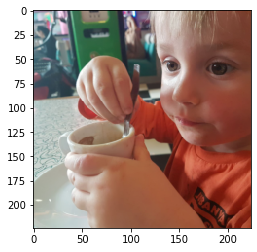

In [0]:
plt.imshow(eugene[:,:,::-1]/255)

(224, 224, 3)

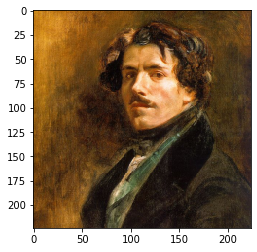

In [0]:
plt.imshow(style[:,:,::-1]/255) 
eugene.shape

In [0]:
eugene_copy=np.copy(eugene) + np.random.normal(224,224,3)

In [0]:
!wget --output-document=vgg19.npy https://media.githubusercontent.com/media/tensorlayer/pretrained-models/master/models/vgg19.npy


class Vgg19:

  def __init__(self, vgg19_npy_path="./vgg19.npy", reuse=False, name="vgg19"):

    self.data_dict = np.load(vgg19_npy_path, encoding='latin1', allow_pickle=True).item()

    self.reuse = reuse

    self.name = name

    self.couches ={}


  def build(self, couche_in):

    self.couches["IN"] = couche_in

    couche_in = couche_in - tf.constant(np.array([103.939, 116.779, 123.68]).reshape((1, 1, 1, 3)), dtype='float32')

    with tf.variable_scope(self.name, reuse=self.reuse):

      struct = ["conv1_1", "conv1_2", "pool1","conv2_1", "conv2_2", 'pool2',

             "conv3_1","conv3_2","conv3_3","conv3_4","pool3","conv4_1",

             "conv4_2","conv4_3","conv4_4","pool4","conv5_1","conv5_2",

             "conv5_3","conv5_4", "pool5", "fc6", "fc7"]

      tmp = couche_in

      for line in struct:

        if line[:4]=="conv":

          tmp = self.conv_layer(tmp, line)

        elif line[:4]=="pool":

          tmp = self.max_pool(tmp, line)

        else:

          tmp = self.fc_layer(tmp, line, relu=True)

      self.data_dict = None


  def get(self, name):

    return self.couches[name]


  def max_pool(self, bottom, name):

    return tf.nn.max_pool(bottom, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME', name=name)


  def conv_layer(self, bottom, name):

    with tf.variable_scope(name):

      filt = tf.constant(self.data_dict[name][0], name="filter")

      conv = tf.nn.conv2d(bottom, filt, [1, 1, 1, 1], padding='SAME')

      conv_biases = tf.constant(self.data_dict[name][1], name="biases")

      bias = tf.nn.bias_add(conv, conv_biases)

      relu = tf.nn.relu(bias)

      self.couches[name] = relu

      return relu


  def fc_layer(self, bottom, name, relu):

    with tf.variable_scope(name):

      x = tf.contrib.layers.flatten(bottom)

      weights = tf.constant(self.data_dict[name][0], name="weights")

      biases = tf.constant(self.data_dict[name][1], name="biases")

      fc = tf.nn.bias_add(tf.matmul(x, weights), biases)

      if relu:

        fc = tf.nn.relu(fc)

      self.couches[name] = fc

      return fc

--2020-02-10 21:45:58--  https://media.githubusercontent.com/media/tensorlayer/pretrained-models/master/models/vgg19.npy
Resolving media.githubusercontent.com (media.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to media.githubusercontent.com (media.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 574670860 (548M) [application/octet-stream]
Saving to: ‘vgg19.npy’

vgg19.npy           100%[===================>] 548.05M   181MB/s    in 3.0s    

2020-02-10 21:46:14 (181 MB/s) - ‘vgg19.npy’ saved [574670860/574670860]



In [0]:
eugene=eugene.reshape(1,224,224,3).astype('float32')
eugene_copy=eugene_copy.reshape(1,224,224,3).astype('float32')
style=style.reshape(1,224,224,3).astype('float32')

In [0]:
tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES)

[<tf.Variable 'Variable:0' shape=(1, 224, 224, 3) dtype=float32_ref>]

In [0]:
tf.reset_default_graph() 
sess=tf.Session() 
VggRef=Vgg19(reuse=False,name="ref") 
VggRef.build(couche_in=tf.constant(eugene)) 



VggStyle=Vgg19(reuse=True,name="style") 
VggStyle.build(couche_in=tf.constant(style)) 

VggMod=Vgg19(reuse=True,name="in_mod") 
VggMod.build(couche_in=tf.Variable(eugene_copy,name='merde'))

In [0]:
def d_euclid(cnnA,cnnB,styles): 
    cost=0.0 
    for style in styles : 
        F= cnnA.get(style) 
        G=cnnB.get(style) 
        C=0.5*tf.reduce_sum(tf.pow(G-F,2)) 
        cost = cost + C 
    return cost 

In [0]:
def d_gramm(cnnA,cnnB,styles): 
    cost=0.0 
    for style in styles : 
        F= cnnA.get(style) 
        G=cnnB.get(style)  
        M=int(F.shape[1]*F.shape[2]) 
        N=int(F.shape[3]) 
        F=tf.reshape(F,(1,M,N))
        F=tf.matmul(tf.transpose(F,(0,2,1)),F) 

        G=tf.reshape(G,(1,M,N))
        G=tf.matmul(tf.transpose(G,(0,2,1)),G)

        C= (1.0/(M**2*4.0*N**2))*tf.reduce_sum(tf.pow(G-F,2)) 
        cost = cost + C 
    return cost  




In [0]:
sess.run(tf.global_variables_initializer())
tvars=tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES)

couches_utilisees_euc = ["conv1_2"]
couches_utilisees_gram = ['conv2_2','conv3_2','conv4_2']
costSty=d_gramm(VggMod,VggStyle,couches_utilisees_gram) 
costEuc=d_euclid(VggMod,VggRef,couches_utilisees_euc) 
cost = costSty*0.33+costEuc*0.66
train=tf.train.AdamOptimizer(0.01).minimize(cost,var_list=tvars) 



global_vars=tf.global_variables() 
is_not_initialized=sess.run([tf.is_variable_initialized(var) for var in global_vars]) 
not_initialized_vars = [v for (v,f) in zip(global_vars, is_not_initialized) if not f]
if len(not_initialized_vars)>0:
    print("SANS INIT =>", not_initialized_vars)
    sess.run(tf.variables_initializer(not_initialized_vars))

SANS INIT => [<tf.Variable 'beta1_power_1:0' shape=() dtype=float32_ref>, <tf.Variable 'beta2_power_1:0' shape=() dtype=float32_ref>, <tf.Variable 'merde/Adam_2:0' shape=(1, 224, 224, 3) dtype=float32_ref>, <tf.Variable 'merde/Adam_3:0' shape=(1, 224, 224, 3) dtype=float32_ref>]


0


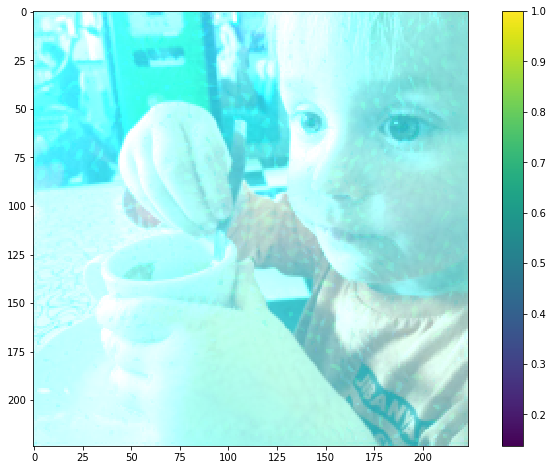

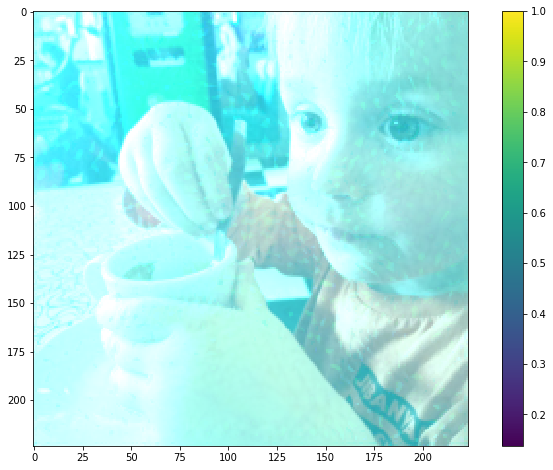

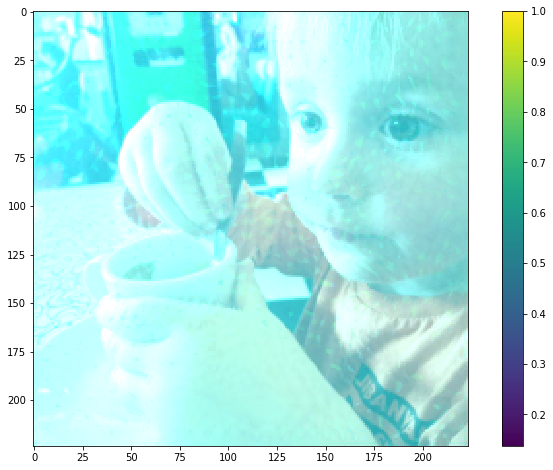

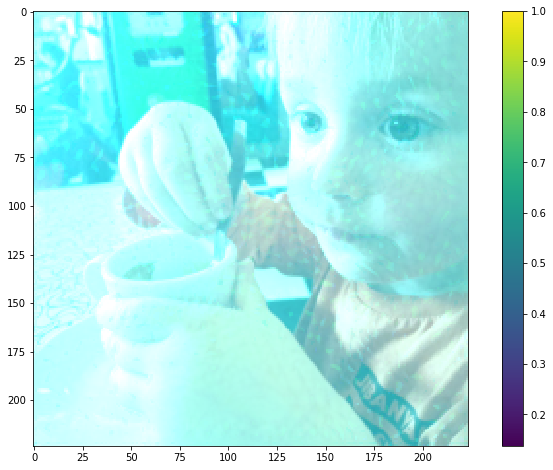

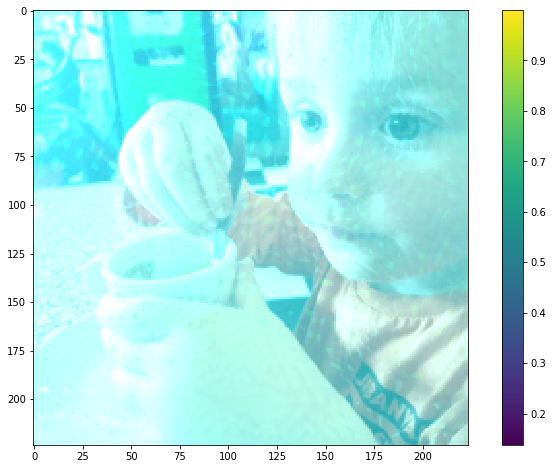

...

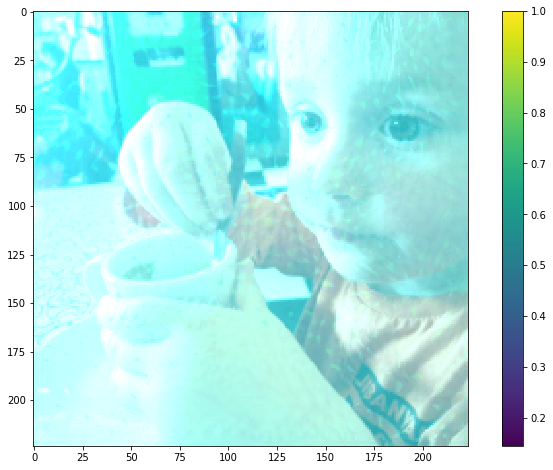

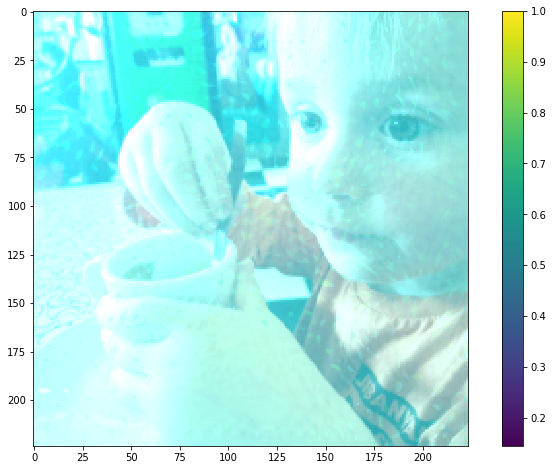

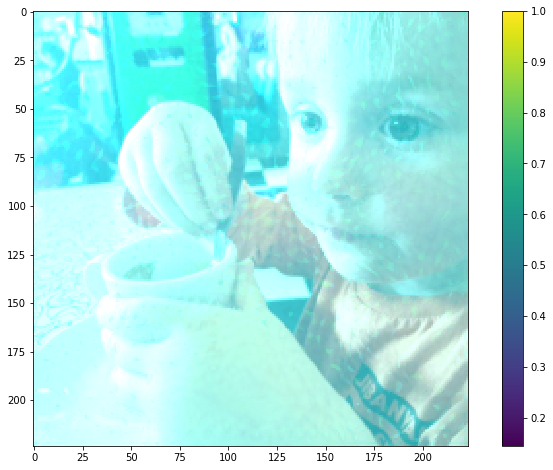

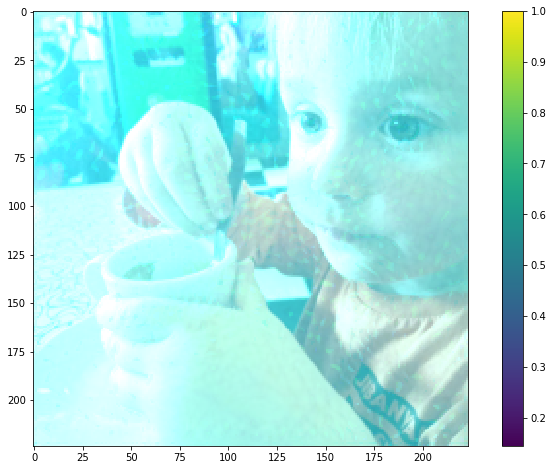

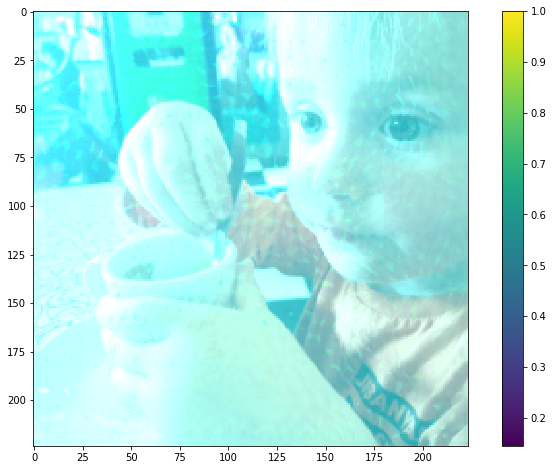

KeyboardInterrupt: ignored

In [0]:


Putaindimage=tf.placeholder(tf.float32,shape=eugene.shape)




for i in range(0,10000): 
    sess.run(train) 
    if i% 1000 ==0 : 
        #clear_output(wait=True) 
        print(i) 
    plt.figure(figsize=(12,8)) 
    img=sess.run(VggMod.couches['IN']) 
    img[img > 255]=255 
    img[img<0]=0 
    img=img[0,:,:,::-1] 
    plt.imshow(img/255.0) 
    plt.colorbar() 
    plt.show()

In [0]:
img

In [0]:
VggMod[couches_utilisees_euc]

TypeError: ignored

{'IN': <tf.Variable 'merde:0' shape=(1, 224, 224, 3) dtype=float32_ref>,
 'conv1_1': <tf.Tensor 'in_mod/conv1_1/Relu:0' shape=(1, 224, 224, 64) dtype=float32>,
 'conv1_2': <tf.Tensor 'in_mod/conv1_2/Relu:0' shape=(1, 224, 224, 64) dtype=float32>,
 'conv2_1': <tf.Tensor 'in_mod/conv2_1/Relu:0' shape=(1, 112, 112, 128) dtype=float32>,
 'conv2_2': <tf.Tensor 'in_mod/conv2_2/Relu:0' shape=(1, 112, 112, 128) dtype=float32>,
 'conv3_1': <tf.Tensor 'in_mod/conv3_1/Relu:0' shape=(1, 56, 56, 256) dtype=float32>,
 'conv3_2': <tf.Tensor 'in_mod/conv3_2/Relu:0' shape=(1, 56, 56, 256) dtype=float32>,
 'conv3_3': <tf.Tensor 'in_mod/conv3_3/Relu:0' shape=(1, 56, 56, 256) dtype=float32>,
 'conv3_4': <tf.Tensor 'in_mod/conv3_4/Relu:0' shape=(1, 56, 56, 256) dtype=float32>,
 'conv4_1': <tf.Tensor 'in_mod/conv4_1/Relu:0' shape=(1, 28, 28, 512) dtype=float32>,
 'conv4_2': <tf.Tensor 'in_mod/conv4_2/Relu:0' shape=(1, 28, 28, 512) dtype=float32>,
 'conv4_3': <tf.Tensor 'in_mod/conv4_3/Relu:0' shape=(1, 28, 